In [1]:
# Importar las librerías necesarias
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import silhouette_score
import hvplot.pandas  # Asegúrate de importar hvplot

In [2]:
# Configurar estilos para los gráficos
sns.set(style="whitegrid")
plt.rcParams['figure.figsize'] = (14, 7)

In [3]:
# Leer el archivo CSV
csv = '2025_02.csv'
df = pd.read_csv(csv)

In [4]:
# Limpiar el encoding de columnas (si es necesario)
def limpiar_columnas(df):
    df.columns = df.columns.str.strip()  # Eliminar espacios en blanco de los nombres de columna
    return df

# Aplicar la función de limpieza de columnas
df = limpiar_columnas(df)

In [5]:
# Convertir las fechas y horas a tipos de datos datetime
df['Fecha_Retiro'] = pd.to_datetime(df['Fecha_Retiro'], format='%d/%m/%Y')
df['Hora_Retiro'] = pd.to_datetime(df['Hora_Retiro'], format='%H:%M:%S').dt.time

In [6]:
# Crear una nueva columna para la hora del día de retiro
df['Hora_Del_Dia_Retiro'] = df['Fecha_Retiro'].dt.hour

In [7]:
# Crear una representación única para cada ruta
df['Ruta'] = df['Ciclo_Estacion_Retiro'].astype(str) + '-' + df['Ciclo_EstacionArribo'].astype(str)

In [8]:
# Función para limpiar la columna de estaciones
def limpiar_estacion(estacion):
    # Si hay un guion, tomamos el primer número
    if '-' in str(estacion):
        return int(estacion.split('-')[0])  # Tomamos el primer número como entero
    else:
        return int(estacion)  # Convertir el valor a entero

# Aplicar la función de limpieza a las columnas de estaciones
df['Ciclo_Estacion_Retiro'] = df['Ciclo_Estacion_Retiro'].apply(limpiar_estacion)
df['Ciclo_EstacionArribo'] = df['Ciclo_EstacionArribo'].apply(limpiar_estacion)

In [9]:
# Preparar los datos para el clustering
X = df[['Ciclo_Estacion_Retiro', 'Ciclo_EstacionArribo', 'Hora_Del_Dia_Retiro']]

In [19]:
# Gráfico de Elbow para determinar el número óptimo de clústeres
inertia = []
K_range = range(1, 11)  # Probar valores de 1 a 10 clústeres

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    inertia.append(kmeans.inertia_)

# Crear un DataFrame para la visualización
elbow_df = pd.DataFrame({'Número de Clústeres': K_range, 'Inercia': inertia})

# Visualización del gráfico de Elbow con hvplot
elbow_plot = elbow_df.hvplot.line(
    x='Número de Clústeres', 
    y='Inercia', 
    title='Elbow Plot', 
    xlabel='Cluster Numbers', 
    ylabel='Inertia', 
    grid=True
)

# Mostrar la visualización
elbow_plot

:Curve   [Número de Clústeres]   (Inercia)

In [11]:
# Aplicar K-Means clustering
kmeans = KMeans(n_clusters=4, random_state=42)  # Ajusta el número de clústeres según sea necesario
df['Cluster'] = kmeans.fit_predict(X)

In [26]:
# Visualizar clústeres usando hvplot
clustered_plot = df.hvplot.scatter(
    x='Ciclo_Estacion_Retiro',
    y='Ciclo_EstacionArribo',
    c='Cluster',
    cmap='mako',
    title='Clusters of Bicycles Routes',
    xlabel='Pickup Station',
    ylabel='Drop off Station',
    colorbar=True,
    hover_cols=['Ruta_Nombres']  # Opcional: muestra los nombres de las rutas al pasar el ratón
)

# Mostrar la visualización
clustered_plot

:Scatter   [Ciclo_Estacion_Retiro]   (Ciclo_EstacionArribo,Cluster)

/var/folders/fw/6l5tprsj7yl017s8ym1yb5ch0000gn/T/ipykernel_15860/3325699591.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x='Ruta', order=df['Ruta'].value_counts().head(10).index, palette='viridis')


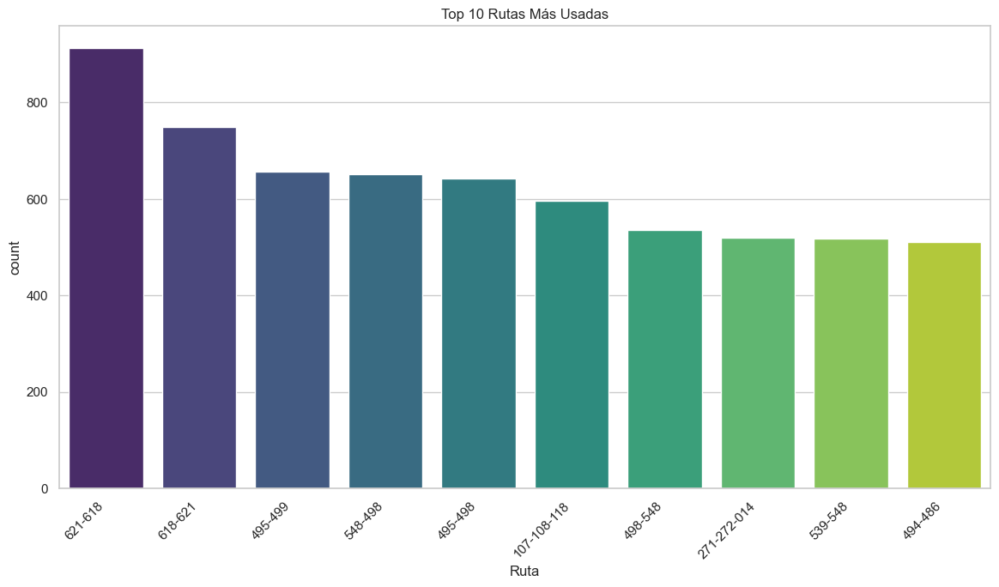

In [13]:
# Visualizar las principales rutas usando clústeres
plt.figure()
sns.countplot(data=df, x='Ruta', order=df['Ruta'].value_counts().head(10).index, palette='viridis')
plt.xticks(rotation=45, ha='right')
plt.title('Top 10 Rutas Más Usadas')
plt.show()

/var/folders/fw/6l5tprsj7yl017s8ym1yb5ch0000gn/T/ipykernel_15860/3931319145.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x='Route_Names', order=df['Route_Names'].value_counts().head(10).index, palette='viridis')


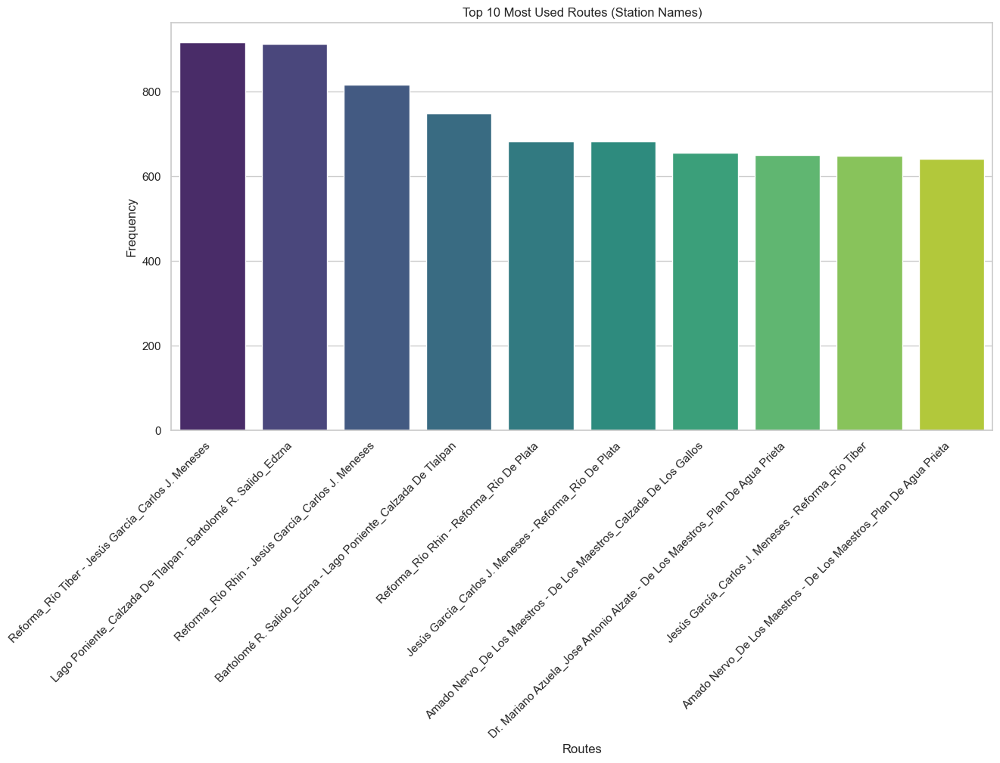

In [15]:
# Leer el archivo CSV con los nombres de las estaciones
estaciones_csv = 'ecobici_edited.csv'
estaciones_df = pd.read_csv(estaciones_csv)

# Limpiar el encoding de columnas en el DataFrame de estaciones
estaciones_df = limpiar_columnas(estaciones_df)

# Aplicar la función de limpieza a la columna num_cicloe
estaciones_df['num_cicloe'] = estaciones_df['num_cicloe'].apply(limpiar_estacion)

# Unir el DataFrame original con el DataFrame de estaciones usando las estaciones de retiro
df = df.merge(estaciones_df[['num_cicloe', 'nombre_estacion']], left_on='Ciclo_Estacion_Retiro', right_on='num_cicloe', how='left')
df.rename(columns={'nombre_estacion': 'Station_Name_Retiro'}, inplace=True)

# Unir el DataFrame original con el DataFrame de estaciones usando las estaciones de arribo
df = df.merge(estaciones_df[['num_cicloe', 'nombre_estacion']], left_on='Ciclo_EstacionArribo', right_on='num_cicloe', how='left')
df.rename(columns={'nombre_estacion': 'Station_Name_Arribo'}, inplace=True)

# Crear una nueva columna que representa las rutas con nombres
df['Route_Names'] = df['Station_Name_Retiro'] + ' - ' + df['Station_Name_Arribo']

# Visualizar las principales rutas usando nombres de estaciones
plt.figure()
sns.countplot(data=df, x='Route_Names', order=df['Route_Names'].value_counts().head(10).index, palette='viridis')
plt.xticks(rotation=45, ha='right')
plt.title('Top 10 Most Used Routes (Station Names)')
plt.xlabel('Routes')
plt.ylabel('Frequency')
plt.show()

In [17]:
from sklearn.metrics import davies_bouldin_score

db_index = davies_bouldin_score(X, df['Cluster'])
print(f"Davies-Bouldin Index: {db_index}")

Davies-Bouldin Index: 0.7593214467531759


# The clustering quality can be interpreted as fair to good, possibly in the range of 50% to 70% accuracy, where the clusters are somewhat intertwined, but some separation can still be seen.

In [28]:
# Calcular las 10 rutas más utilizadas
top_routes = df['Route_Names'].value_counts().head(10).reset_index()
top_routes.columns = ['Route_Names', 'Frequency']

# Imprimir el DataFrame
print("Top 10 Most Used Routes:")
top_routes

Top 10 Most Used Routes:


,Route_Names,Frequency
0,Reforma_Río Tiber - Jesús García_Carlos J. Men...,917
1,Lago Poniente_Calzada De Tlalpan - Bartolomé R...,913
2,Reforma_Río Rhin - Jesús García_Carlos J. Meneses,817
3,Bartolomé R. Salido_Edzna - Lago Poniente_Calz...,748
4,Reforma_Río Rhin - Reforma_Río De Plata,683
5,Jesús García_Carlos J. Meneses - Reforma_Río D...,682
6,Amado Nervo_De Los Maestros - De Los Maestros_...,656
7,Dr. Mariano Azuela_Jose Antonio Alzate - De Lo...,651
8,Jesús García_Carlos J. Meneses - Reforma_Río T...,648
9,Amado Nervo_De Los Maestros - De Los Maestros_...,642


In [29]:
# Exportar el DataFrame a un archivo CSV
top_routes.to_csv('top_10_routes.csv', index=False)
